Initial conditions:
Pendulum       θ₁ (rad)   ω₁ (1/s)   θ₂ (rad)   ω₂ (1/s)
Blue             0.97π       0.00      0.97π       0.00
Red              0.97π       0.00      0.94π       0.00




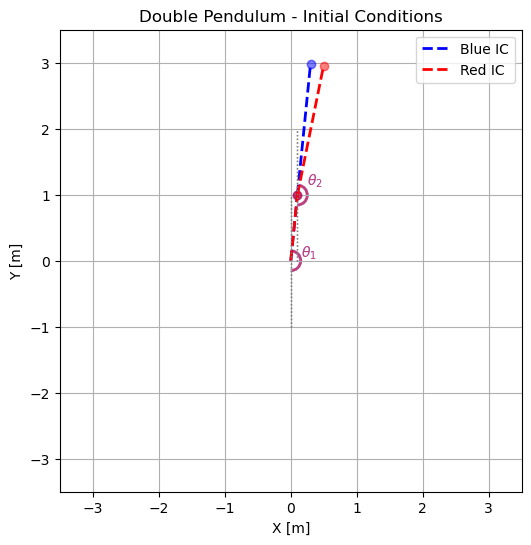

In [1]:
# -------------------------------------------------------------
# Chaotic Dynamics of the Double Pendulum
# -------------------------------------------------------------
# This notebook simulates the double pendulum, a classical example
# of a chaotic system. We demonstrate:
# - Energy conservation as a check of numerical accuracy
# - Sensitivity to initial conditions (hallmark of chaos)
# - Phase space visualization and Poincaré sections
# - Estimation of the largest Lyapunov exponent
# -------------------------------------------------------------


import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import FancyArrowPatch

# -------------------------------------------------------------------
# Initial conditions and system parameters
# -------------------------------------------------------------------
initial_conditions1 = [np.pi - 0.1, 0, np.pi - 0.1, 0]   # [theta1_0, w1_0, theta2_0, w2_0]
initial_conditions2 = [np.pi - 0.1, 0, np.pi - 0.2, 0]   # Slightly different second pendulum angle

g = 9.81  # gravitational acceleration (m/s²)
L1, L2 = 1, 2   # rod lengths (meters)
m1, m2 = 1, 2   # masses (kg)

par = L1, L2, m1, m2, g  # Tuple of parameters

# -------------------------------------------------------------------
# Print initial conditions in a readable table
# -------------------------------------------------------------------
header = f"{'Pendulum':<12} {'θ₁ (rad)':>10} {'ω₁ (1/s)':>10} {'θ₂ (rad)':>10} {'ω₂ (1/s)':>10}"
line1 = f"{'Blue':<12} {initial_conditions1[0]/np.pi:8.2f}π {initial_conditions1[1]:10.2f} {initial_conditions1[2]/np.pi:9.2f}π {initial_conditions1[3]:10.2f}"
line2 = f"{'Red':<12} {initial_conditions2[0]/np.pi:8.2f}π {initial_conditions2[1]:10.2f} {initial_conditions2[2]/np.pi:9.2f}π {initial_conditions2[3]:10.2f}\n\n"

print("Initial conditions:")
print(header)
print(line1)
print(line2)

# -------------------------------------------------------------------
# Function to add angular velocity arrows
# -------------------------------------------------------------------
def add_omega_arrow(x_start, y_start, theta, omega, color, scale=0.3):
    """ Draws a tangent arrow to indicate angular velocity. """
    if omega != 0:
        dx = scale * omega * np.cos(theta)
        dy = scale * omega * np.sin(theta)
        arrow = FancyArrowPatch((x_start, y_start), (x_start + dx, y_start + dy),
                                arrowstyle='->', color=color, mutation_scale=10, lw=1, alpha=0.5)
        plt.gca().add_patch(arrow)
        plt.text(x_start + dx*1.3, y_start + dy*1.3, r'$\omega$', color=color, fontsize=12, alpha=0.5)

# -------------------------------------------------------------------
# Helper function to compute pendulum positions
# -------------------------------------------------------------------
def compute_positions(theta1, theta2):
     """ Return Cartesian positions of pivot, mass1, and mass2. """
    x0, y0 = 0, 0
    x1 = x0 + L1 * np.sin(theta1)
    y1 = y0 - L1 * np.cos(theta1)
    x2 = x1 + L2 * np.sin(theta2)
    y2 = y1 - L2 * np.cos(theta2)
    return (x0, y0, x1, y1, x2, y2)

# -------------------------------------------------------------------
# Plot initial conditions for visual understanding
# -------------------------------------------------------------------
plt.figure(figsize=(6,6))

# Arc radius for angle visualization
arc_radius = 0.15

for ic, color, label in zip([initial_conditions1, initial_conditions2], ['b', 'r'], ['Blue IC', 'Red IC']):
    theta1, w1, theta2, w2 = ic
    x0, y0, x1, y1, x2, y2 = compute_positions(theta1, theta2)
    
    # Rods
    plt.plot([x0, x1], [y0, y1], f'{color}--', lw=2)
    plt.plot([x1, x2], [y1, y2], f'{color}--', lw=2, label=label)
    
    # Bobs
    plt.plot(x1, y1, color, marker="o", linestyle="none", markersize=6, alpha=0.5)
    plt.plot(x2, y2, color, marker="o", linestyle="none", markersize=6, alpha=0.5)
    
    # Vertical guide lines
    plt.vlines(x0, ymin=y0-1, ymax=y0+1, color="gray", linestyle=":", lw=1)
    plt.vlines(x1, ymin=y1-1, ymax=y1+1, color="gray", linestyle=":", lw=1)
    
    # Angle arcs
    arc1 = patches.Arc((x0, y0), 2*arc_radius, 2*arc_radius, angle=0,
                       theta1=-90, theta2=np.degrees(theta1)-90, color=color, lw=2, alpha=0.5)
    plt.gca().add_patch(arc1)
    plt.text(x0 + 0.15, y0 + 0.05, r'$\theta_1$', color=color, fontsize=10, alpha=0.5)
    
    arc2 = patches.Arc((x1, y1), 2*arc_radius, 2*arc_radius, angle=0,
                       theta1=-90, theta2=np.degrees(theta2)-90, color=color, lw=2, alpha=0.5)
    plt.gca().add_patch(arc2)
    plt.text(x1 + 0.15, y1 - 0.25 if color=='red' else y1 + 0.15, r'$\theta_2$', color=color, fontsize=10, alpha=0.5)
    
    # Angular velocity arrows
    add_omega_arrow(x1, y1, theta1, w1, color=color)
    add_omega_arrow(x2, y2, theta2, w2, color=color)

# Plot settings
plt.xlabel("X [m]")
plt.ylabel("Y [m]")
plt.xlim(-L1 - L2 - 0.5, L1 + L2 + 0.5)
plt.ylim(-L1 - L2 - 0.5, L1 + L2 + 0.5)
plt.gca().set_aspect('equal')
plt.grid(True)
plt.title("Double Pendulum - Initial Conditions", fontsize=12)
plt.legend()
plt.show()



Time frame considered: from 0.0 s to 1000.0 s, with dt = 0.00100 s



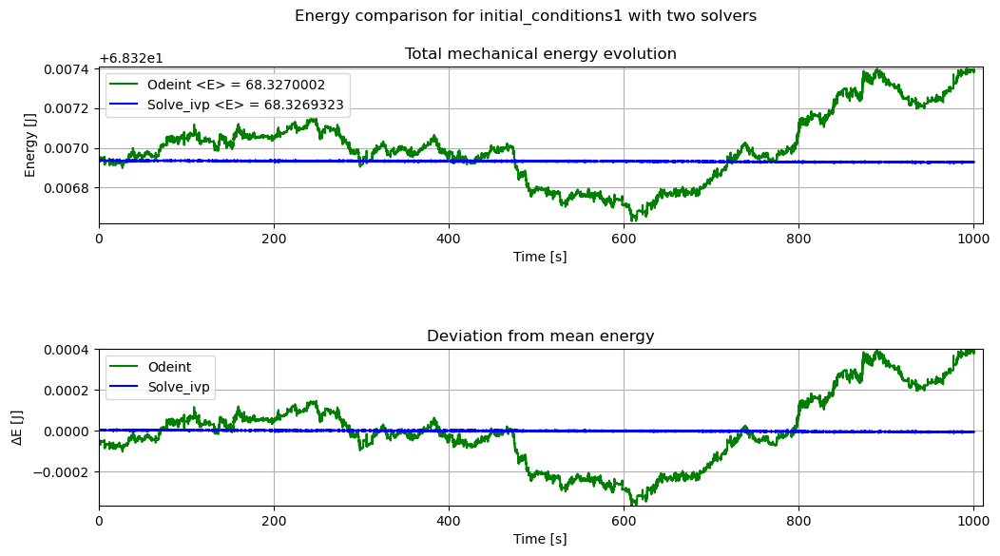

In [2]:
# -------------------------------------------------------------
# Energy conservation check
# -------------------------------------------------------------
# Chaotic dynamics amplify numerical errors.
# To trust our simulations, we check that total mechanical energy
# remains nearly constant over time. This validates the accuracy
# of the ODE solver and chosen tolerances.
# -------------------------------------------------------------


# --- Time frame ---
steps = 1000001
t = np.linspace(0, 1000, steps)
dt = abs(t[0] - t[-1]) / (steps - 1)

print(f"\nTime frame considered: from {t[0]} s to {t[-1]} s, with dt = {dt:.5f} s\n")

from scipy.integrate import odeint, solve_ivp  # Import the two solvers

# -------------------------------------------------------------------
# Functions defining the equations of motion
# -------------------------------------------------------------------

def odeint_solver(state, t, L1, L2, m1, m2, g):
    """Equations of motion for odeint (fixed-step solver)."""
    theta1, w1, theta2, w2 = state
    diff = theta1 - theta2
    m_sum = m1 + m2

    dtheta1_dt = w1
    dtheta2_dt = w2
    dw1_dt = (-g*(2*m1 + m2)*np.sin(theta1)
              - m2*g*np.sin(theta1 - 2*theta2)
              - 2*np.sin(diff)*m2*(w2**2*L2 + w1**2*L1*np.cos(diff))) / (L1 * (2*m1 + m2 - m2*np.cos(2*diff)))
    dw2_dt = (2*np.sin(diff)*(w1**2*L1*m_sum + g*m_sum*np.cos(theta1) + w2**2*L2*m2*np.cos(diff))) / (L2 * (2*m1 + m2 - m2*np.cos(2*diff)))

    return [dtheta1_dt, dw1_dt, dtheta2_dt, dw2_dt]

def ivp_solver(t, state, L1, L2, m1, m2, g):
    """Equations of motion for solve_ivp (adaptive-step solver)."""
    theta1, w1, theta2, w2 = state
    diff = theta1 - theta2
    m_sum = m1 + m2

    dtheta1_dt = w1
    dtheta2_dt = w2
    dw1_dt = (-g*(2*m1 + m2)*np.sin(theta1)
              - m2*g*np.sin(theta1 - 2*theta2)
              - 2*np.sin(diff)*m2*(w2**2*L2 + w1**2*L1*np.cos(diff))) / (L1 * (2*m1 + m2 - m2*np.cos(2*diff)))
    dw2_dt = (2*np.sin(diff)*(w1**2*L1*m_sum + g*m_sum*np.cos(theta1) + w2**2*L2*m2*np.cos(diff))) / (L2 * (2*m1 + m2 - m2*np.cos(2*diff)))

    return [dtheta1_dt, dw1_dt, dtheta2_dt, dw2_dt]

# -------------------------------------------------------------------
# Solve using odeint (fixed-step)
# -------------------------------------------------------------------
sol_odeint = odeint(odeint_solver, initial_conditions1, t, args=par)
theta1_o, w1_o, theta2_o, w2_o = sol_odeint.T

# -------------------------------------------------------------------
# Solve using solve_ivp (adaptive-step RK45)
# -------------------------------------------------------------------
t_span = (t[0], t[-1])
sol_ivp = solve_ivp(ivp_solver, t_span, initial_conditions1, args=par, method="RK45",
                     t_eval=t, rtol=1e-9, atol=1e-12)
theta1_l, w1_l, theta2_l, w2_l = sol_ivp.y

# -------------------------------------------------------------------
# Compute total mechanical energy: E = T + V
# -------------------------------------------------------------------
E_o, Eo_diff = [], []
E_l, El_diff = [], []

for th1, w1, th2, w2 in zip(theta1_o, w1_o, theta2_o, w2_o):
    diff = th1 - th2
    T = 0.5*(m1 + m2)*L1**2*w1**2 + 0.5*m2*L2**2*w2**2 + m2*L1*L2*w1*w2*np.cos(diff)
    V = -(m1 + m2)*g*L1*np.cos(th1) - m2*g*L2*np.cos(th2)
    E_o.append(T + V)

for th1, w1, th2, w2 in zip(theta1_l, w1_l, theta2_l, w2_l):
    diff = th1 - th2
    T = 0.5*(m1 + m2)*L1**2*w1**2 + 0.5*m2*L2**2*w2**2 + m2*L1*L2*w1*w2*np.cos(diff)
    V = -(m1 + m2)*g*L1*np.cos(th1) - m2*g*L2*np.cos(th2)
    E_l.append(T + V)

E_o = np.array(E_o)
Eo_diff = E_o - np.mean(E_o)
E_l = np.array(E_l)
El_diff = E_l - np.mean(E_l)

# -------------------------------------------------------------------
# Plot energy evolution and deviation from mean
# -------------------------------------------------------------------
fig, axes = plt.subplots(2, 1, figsize=(12, 6))
plt.subplots_adjust(wspace=0.4, hspace=0.8)
fig.suptitle("Energy comparison for initial_conditions1 with two solvers")

# Energy evolution
axes[0].plot(t, E_o, color="green", linestyle="-", label=rf"Odeint <E> = {np.mean(E_o):.7f}")
axes[0].plot(t, E_l, color="blue", linestyle="-", label=rf"Solve_ivp <E> = {np.mean(E_l):.7f}")
axes[0].set_title("Total mechanical energy evolution")
axes[0].set_xlabel("Time [s]")
axes[0].set_ylabel("Energy [J]")
axes[0].set_xlim(t[0] - 0.1, t[-1]*1.01)
axes[0].set_ylim(min(E_l.min(), E_o.min()) - 1e-5, max(E_l.max(), E_o.max()) + 1e-5)
axes[0].grid(True)
axes[0].legend()

# Difference from mean energy
axes[1].plot(t, Eo_diff, color="green", linestyle="-", label="Odeint")
axes[1].plot(t, El_diff, color="blue", linestyle="-", label="Solve_ivp")
axes[1].set_title("Deviation from mean energy")
axes[1].set_xlabel("Time [s]")
axes[1].set_ylabel(r"$\Delta$E [J]")
axes[1].set_xlim(t[0] - 0.1, t[-1]*1.01)
axes[1].set_ylim(min(El_diff.min(), Eo_diff.min())*0.99, max(El_diff.max(), Eo_diff.max())*1.01)
axes[1].grid(True)
axes[1].legend()

plt.show()

# -------------------------------------------------------------------
# Comment
# -------------------------------------------------------------------
# ---Choice of solver---
# Solve_ivp is preferred here because it provides a stable energy behavior.
# Note: Solve_ivp with adaptive steps can be left free to choose its
# internal timesteps, but then comparison at fixed t values is not possible.
# --- Choice of time ---
# For animations and analysis, we limit the time to max 400 seconds.
# Beyond this, the solver starts to accumulate energy drift, which can affect the accuracy of the simulation.
# -------------------------------------------------------------------


In [3]:
#------------
# Showcase the chaotic motion of two double pendulums with nearby initial conditions
# This animation highlights:
#   - Sensitivity to initial conditions (chaos)
#   - Fading trails for better visualization of past trajectories
#------------


# Note: "%matplotlib widget" works in Jupyter notebooks.
# Use "%matplotlib inline" for static plots in exported notebooks.
%matplotlib widget



from matplotlib.animation import FuncAnimation
from IPython.display import HTML 

# -------------------------------------------------------------------
# We simulate for 15 seconds with 561 steps.
# Note: higher simulation times or denser steps increase accuracy,
# but also make the animation heavier. 
#In the next cells the time is increased for better studying. Here is sufficient some seconds to understand visually what's happening.
# -------------------------------------------------------------------

steps = 561
t = np.linspace(0, 15, steps)
dt = abs(t[0] - t[-1]) / (steps - 1)
t_span = (t[0], t[-1])
print(f"\nTime frame considered:\nFrom {t[0]} s to {t[-1]} s, with dt = {dt:.5f} s\n")

# -------------------------------------------------------------------
# Solve ODEs for two slightly different initial conditions
# The difference in ICs will cause the trajectories to diverge,
# demonstrating the chaotic nature of the system.
# -------------------------------------------------------------------

sol_ivp_b = solve_ivp(ivp_solver, t_span, initial_conditions1, args=par, method="RK45",
                     t_eval=t, rtol=1e-9, atol=1e-12)
sol_ivp_r = solve_ivp(ivp_solver, t_span, initial_conditions2, args=par, method="RK45",
                     t_eval=t, rtol=1e-9, atol=1e-12)

# Extract angular positions/velocities for both pendulums
b_theta1, b_w1, b_theta2, b_w2 = sol_ivp_b.y # blue pendulum (IC1)
r_theta1, r_w1, r_theta2, r_w2 = sol_ivp_r.y # red pendulum (IC2)

# -------------------------------------------------------------------
# Figure setup
# -------------------------------------------------------------------

fig, ax = plt.subplots(figsize=(6,6))
ax.set_xlim(-L1-L2-0.5, L1+L2+0.5)
ax.set_ylim(-L1-L2-0.5, L1+L2+0.5)
ax.set_aspect('equal')
ax.grid(True)
ax.set_xlabel("X [m]")
ax.set_ylabel("Y [m]")
ax.set_title("Double Pendulum - Chaotic Motion \n", fontsize=12)

# Pendulum rods (lines connecting pivot --> mass1 --> mass2)
b_line, = ax.plot([], [], 'bo-', lw=2, label="IC 1")
r_line, = ax.plot([], [], 'ro-', lw=2, label="IC 2")

ax.legend()

# --- Trail parameters ---
trail_length = 30  # number of past points to keep in the trail
b_trail_x, b_trail_y = [], []
r_trail_x, r_trail_y = [], []

# Scatter objects to draw fading trails
b_scatter = ax.scatter([], [], c="b", s=10)
r_scatter = ax.scatter([], [], c="r", s=10)

# --- Animation function ---
def animate(i):
    # Compute Cartesian coordinates of the pendulum masses
    x0, y0, x1_b, y1_b, x2_b, y2_b = compute_positions(b_theta1[i], b_theta2[i])
    _, _, x1_r, y1_r, x2_r, y2_r = compute_positions(r_theta1[i], r_theta2[i])

    # Update pendulum rods
    b_line.set_data([x0, x1_b, x2_b], [y0, y1_b, y2_b])
    r_line.set_data([x0, x1_r, x2_r], [y0, y1_r, y2_r])

    # Update trail positions (store last N positions)
    b_trail_x.append(x2_b); b_trail_y.append(y2_b)
    r_trail_x.append(x2_r); r_trail_y.append(y2_r)

    if len(b_trail_x) > trail_length:
        b_trail_x.pop(0); b_trail_y.pop(0)
    if len(r_trail_x) > trail_length:
        r_trail_x.pop(0); r_trail_y.pop(0)

    # Fading effect for trails: older points are more transparent
    alphas = np.linspace(0.1, 1.0, len(b_trail_x))
    b_colors = [(0, 0, 1, a) for a in alphas]  # blue fading
    r_colors = [(1, 0, 0, a) for a in alphas]  # red fading

    b_scatter.set_offsets(np.c_[b_trail_x, b_trail_y])
    r_scatter.set_offsets(np.c_[r_trail_x, r_trail_y])
    b_scatter.set_color(b_colors)
    r_scatter.set_color(r_colors)

    # Update title with current time
    ax.set_title(f"Double Pendulum - Chaotic Motion\n t = {t[i]:.2f} s")

    return b_line, r_line, b_scatter, r_scatter

# --- Create animation ---
plt.close("all")  # prevent duplicate static figure
anim = FuncAnimation(fig, animate, frames=len(t), interval=250, blit=True, repeat=False)

# Display animation in notebook
HTML(anim.to_jshtml())



Time frame considered:
From 0.0 s to 15.0 s, with dt = 0.02679 s




Time frame considered:
From 0.0 s to 60.0 s, with dt = 0.00600 s



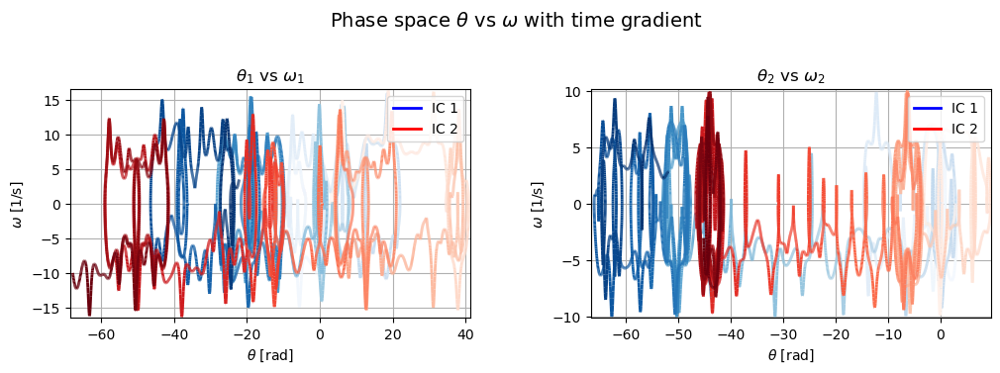

In [4]:
# -------------------------------------------------------------
# Phase Space Trajectories of the Double Pendulum
# -------------------------------------------------------------
# This section visualizes the phase space of two double pendulum systems 
# with slightly different initial conditions (ICs). 
# Each subplot shows the evolution of angular position vs. angular velocity 
# for one of the pendulum masses.
# A color gradient indicates the progression of time along each trajectory, 
# illustrating chaotic divergence.
# -------------------------------------------------------------

from matplotlib.collections import LineCollection


#-------------------------------------------------------------
# We plot the phase space for 60 seconds. More points would make the graph heavier and not readable.
# The accuracy in time is not requested, as we are searching only for visual qualitive understanding. 
#-------------------------------------------------------------
steps = 10001
t = np.linspace(0, 60, steps)
dt = abs(t[0] - t[-1]) / (steps - 1)
t_span = (t[0], t[-1])
print(f"\nTime frame considered:\nFrom {t[0]} s to {t[-1]} s, with dt = {dt:.5f} s\n")

# -------------------------------------------------------------------
# Solve ODEs for two slightly different initial conditions
# The difference in ICs will cause the trajectories to diverge,
# demonstrating the chaotic nature of the system.
# -------------------------------------------------------------------

sol_ivp_b = solve_ivp(ivp_solver, t_span, initial_conditions1, args=par, method="RK45",
                     t_eval=t, rtol=1e-9, atol=1e-12)
sol_ivp_r = solve_ivp(ivp_solver, t_span, initial_conditions2, args=par, method="RK45",
                     t_eval=t, rtol=1e-9, atol=1e-12)

# Extract angular positions/velocities for both pendulums
b_theta1, b_w1, b_theta2, b_w2 = sol_ivp_b.y # blue pendulum (IC1)
r_theta1, r_w1, r_theta2, r_w2 = sol_ivp_r.y # red pendulum (IC2)

#-----------------------------------------------------------


# -------------------------------------------------------------
# Function to create a gradient line based on time
# -------------------------------------------------------------
def gradient_line(x, y, cmap='viridis'):
    """
    Create a LineCollection with a color gradient to represent the passage of time along a trajectory.

    Parameters:
    x : array-like
        X coordinates of the trajectory (angle θ)
    y : array-like
        Y coordinates of the trajectory (angular velocity ω)
    cmap : str
        Matplotlib colormap to visualize the temporal evolution

    Returns:
    lc : LineCollection
        A matplotlib LineCollection object with a smooth color gradient
    """
    # Stack points into segments for LineCollection
    points = np.array([x, y]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)

    # Normalize colors along the trajectory
    norm = plt.Normalize(0, len(x)-1)
    lc = LineCollection(segments, cmap=cmap, norm=norm)
    lc.set_array(np.arange(len(x)))  # Gradient index increases with time
    lc.set_linewidth(2)              # Thickness of the trajectory line
    return lc

# -------------------------------------------------------------
# Prepare figure and axes
# -------------------------------------------------------------
%matplotlib inline
plt.close("all")  # Close previous figures

fig, axes = plt.subplots(1, 2, figsize=(12, 3))  # Two subplots side-by-side
plt.subplots_adjust(wspace=0.3)                  # Adjust horizontal spacing
fig.suptitle(r"Phase space $\theta$ vs $\omega$ with time gradient", fontsize=14, y=1.15)

# -------------------------------------------------------------
# Phase space for pivot --> mass1 (θ₁ vs ω₁)
# -------------------------------------------------------------
# Create gradient lines for IC1 and IC2
lc_b1 = gradient_line(b_theta1, b_w1, cmap='Blues')  # Blue: initial condition 1
lc_r1 = gradient_line(r_theta1, r_w1, cmap='Reds')   # Red: initial condition 2

# Add lines to the axes
axes[0].add_collection(lc_b1)
axes[0].add_collection(lc_r1)

# Set axis labels, title, and limits
axes[0].set_title(r"$\theta_1$ vs $\omega_1$")
axes[0].set_xlabel(r"$\theta$ [rad]")
axes[0].set_ylabel(r"$\omega$ [1/s]")
axes[0].set_xlim(min(b_theta1.min(), r_theta1.min())*1.01, max(b_theta1.max(), r_theta1.max())*1.01)
axes[0].set_ylim(min(b_w1.min(), r_w1.min())*1.01, max(b_w1.max(), r_w1.max())*1.01)
axes[0].grid(True)

# Add dummy lines for legend clarity
axes[0].plot([], [], color='blue', lw=2, label="IC 1")
axes[0].plot([], [], color='red', lw=2, label="IC 2")
axes[0].legend()

# -------------------------------------------------------------
# Phase space for mass1 --> mass2 (θ₂ vs ω₂)
# -------------------------------------------------------------
lc_b2 = gradient_line(b_theta2, b_w2, cmap='Blues')  # Blue: initial condition 1
lc_r2 = gradient_line(r_theta2, r_w2, cmap='Reds')   # Red: initial condition 2

axes[1].add_collection(lc_b2)
axes[1].add_collection(lc_r2)

axes[1].set_title(r"$\theta_2$ vs $\omega_2$")
axes[1].set_xlabel(r"$\theta$ [rad]")
axes[1].set_ylabel(r"$\omega$ [1/s]")
axes[1].set_xlim(min(b_theta2.min(), r_theta2.min())*1.01, max(b_theta2.max(), r_theta2.max())*1.01)
axes[1].set_ylim(min(b_w2.min(), r_w2.min())*1.01, max(b_w2.max(), r_w2.max())*1.01)
axes[1].grid(True)

# Dummy lines for legend
axes[1].plot([], [], color='blue', lw=2, label="IC 1")
axes[1].plot([], [], color='red', lw=2, label="IC 2")
axes[1].legend()

# -------------------------------------------------------------
# Display the figure
# -------------------------------------------------------------
plt.show()

# -------------------------------------------------------------
# Comments
# -------------------------------------------------------------
# 1. Each subplot shows the phase-space trajectory of a pendulum mass:
#    - Left: pivot --> mass1 (θ₁ vs ω₁)
#    - Right: mass1 --> mass2 (θ₂ vs ω₂)
# 2. The color gradient along each trajectory encodes time, illustrating
#    how the pendulum evolves dynamically.
# 3. IC1 and IC2 trajectories diverge due to the chaotic nature of the double pendulum,
#    making it visually clear how sensitive the system is to initial conditions.



Time frame considered:
From 0.0 s to 600.0 s, with dt = 0.0006000000 s



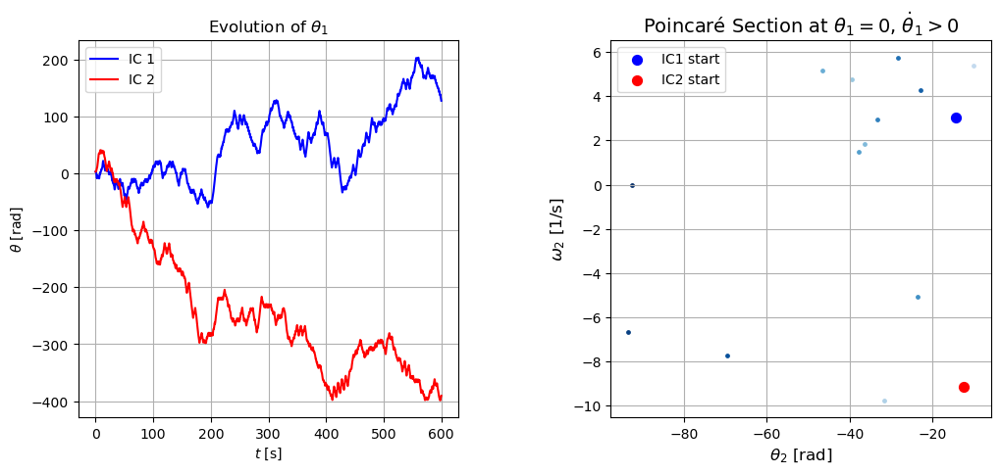

In [5]:
# -------------------------------------------------------------
# Poincaré section
# -------------------------------------------------------------
# To analyze chaos, we slice the 4D phase space at θ₁ = 0
# (upward crossings only) and plot (θ₂, ω₂).
# Regular systems produce closed curves; chaotic systems give
# scattered points. A time-gradient highlights the evolution.
# -------------------------------------------------------------


# -------------------------------------------------------------
# Parameters for high-resolution integration
# -------------------------------------------------------------
steps = 1000001             # large number of points to accurately catch zero crossings
t = np.linspace(0, 600, steps) # We choose 600 as time limit following the discussion of the second cell
dt = abs(t[0] - t[-1]) / (steps - 1)
t_span = (t[0], t[-1])
print(f"\nTime frame considered:\nFrom {t[0]} s to {t[-1]} s, with dt = {dt:.10f} s\n")

# -------------------------------------------------------------
# Solve ODEs for two slightly different initial conditions
# -------------------------------------------------------------
sol_ivp_b = solve_ivp(ivp_solver, t_span, initial_conditions1, args=par,
                      method="RK45", t_eval=t, rtol=1e-9, atol=1e-12)
sol_ivp_r = solve_ivp(ivp_solver, t_span, initial_conditions2, args=par,
                      method="RK45", t_eval=t, rtol=1e-9, atol=1e-12)

# Extract angular positions/velocities
b_theta1, b_w1, b_theta2, b_w2 = sol_ivp_b.y
r_theta1, r_w1, r_theta2, r_w2 = sol_ivp_r.y

# -------------------------------------------------------------
# Detect zero-crossings θ₁ = 0 (upwards) using linear interpolation
# -------------------------------------------------------------
b_theta2_cross, b_w2_cross, b_time_cross = [], [], []
r_theta2_cross, r_w2_cross, r_time_cross = [], [], []

for i in range(1, len(b_theta1)):
    # Blue pendulum (IC1)
    if b_theta1[i-1] < 0 and b_theta1[i] > 0 and b_w1[i] > 0:
        frac = -b_theta1[i-1] / (b_theta1[i] - b_theta1[i-1])
        b_theta2_cross.append(b_theta2[i-1] + frac * (b_theta2[i] - b_theta2[i-1]))
        b_w2_cross.append(b_w2[i-1] + frac * (b_w2[i] - b_w2[i-1]))
        b_time_cross.append(t[i-1] + frac * (t[i] - t[i-1]))

    # Red pendulum (IC2)
    if r_theta1[i-1] < 0 and r_theta1[i] > 0 and r_w1[i] > 0:
        frac = -r_theta1[i-1] / (r_theta1[i] - r_theta1[i-1])
        r_theta2_cross.append(r_theta2[i-1] + frac * (r_theta2[i] - r_theta2[i-1]))
        r_w2_cross.append(r_w2[i-1] + frac * (r_w2[i] - r_w2[i-1]))
        r_time_cross.append(t[i-1] + frac * (t[i] - t[i-1]))

# -------------------------------------------------------------
# Plot settings
# -------------------------------------------------------------
fig, axes = plt.subplots(1, 2, figsize=(12, 5))  # Two subplots side-by-side
plt.subplots_adjust(wspace=0.4)


# -------------------------------------------------------------
# Plot θ₁(t) to see if motion oscillates around zero (regular)
# or drifts/rotates continuously (chaotic signature).
# -------------------------------------------------------------

axes[0].plot(t, b_theta1, label="IC 1", c="b" )
axes[0].plot(t, r_theta1, label="IC 2", c="r")
axes[0].set_title(r"Evolution of $\theta_1$")
axes[0].set_ylabel(r"$\theta$ [rad]")
axes[0].set_xlabel(r"$t$ [s]")
axes[0].legend()
axes[0].grid(True)


# -------------------------------------------------------------
# Plot the Poincaré section with time-gradient coloring
# -------------------------------------------------------------
# Gradient colors for IC1 (blue)
colors_b = plt.cm.Blues(np.linspace(0.2, 1, len(b_theta2_cross)))
for i in range(len(b_theta2_cross)):
    axes[1].scatter(b_theta2_cross[i], b_w2_cross[i], color=colors_b[i], s=6)

# Gradient colors for IC2 (red)
colors_r = plt.cm.Reds(np.linspace(0.2, 1, len(r_theta2_cross)))
for i in range(len(r_theta2_cross)):
    axes[1].scatter(r_theta2_cross[i], r_w2_cross[i], color=colors_r[i], s=6)

# Mark initial points
axes[1].scatter(b_theta2_cross[0], b_w2_cross[0], color='blue', s=50, marker='o', label='IC1 start')
axes[1].scatter(r_theta2_cross[0], r_w2_cross[0], color='red', s=50, marker='o', label='IC2 start')

# Labels and title
axes[1].set_xlabel(r"$\theta_2$ [rad]", fontsize=12)
axes[1].set_ylabel(r"$\omega_2$ [1/s]", fontsize=12)
axes[1].set_title(r"Poincaré Section at $\theta_1 = 0$, $\dot{\theta}_1 > 0$", fontsize=14)
axes[1].legend()
axes[1].grid(True)
#plt.tight_layout()
plt.show()

# -------------------------------------------------------------
# Comments
# -------------------------------------------------------------
# Left graph: Evolution of θ₁ over time
# - This plot shows how the angle of the first pendulum changes over the simulation.
# - The blue and red lines correspond to two slightly different initial conditions (IC1 and IC2).
# - Observing θ₁(t) helps us understand the motion regime:
#     * If θ₁ oscillates around zero, the pendulum behaves approximately periodically.
#     * If θ₁ grows unbounded or rotates continuously, the pendulum is in a rotational regime.
# - Comparing the two lines highlights the sensitivity to initial conditions: even small differences lead to diverging trajectories over time, demonstrating chaos.
# - This plot also justifies why the Poincaré section takes θ₁ = 0 crossings: it’s a natural Poincaré plane for detecting the system’s 2D slice.

# Right graph: Poincaré section (θ₂ vs ω₂ at θ₁ = 0)
# - Each scatter point represents the state of the second pendulum at the exact moment the first pendulum crosses θ₁ = 0 in the positive direction.
# - Color gradient shows the progression of time along the trajectory: darker points correspond to later times.
# - The highlighted initial points (larger, darker markers) show where each trajectory starts, making divergence visually obvious.
# - The scatter distribution illustrates chaotic divergence:
#     * Points do not form smooth curves (as would happen in a periodic or quasi-periodic system).
#     * Nearby trajectories spread rapidly, filling a region in phase space.
# - Together, the two graphs give a complete picture of chaotic behavior:
#     * Left: divergence over time
#     * Right: structure of phase space and sensitive dependence on initial conditions.



Time frame considered:
From 0.0 s to 15.0 s, with dt = 0.0001500000 s



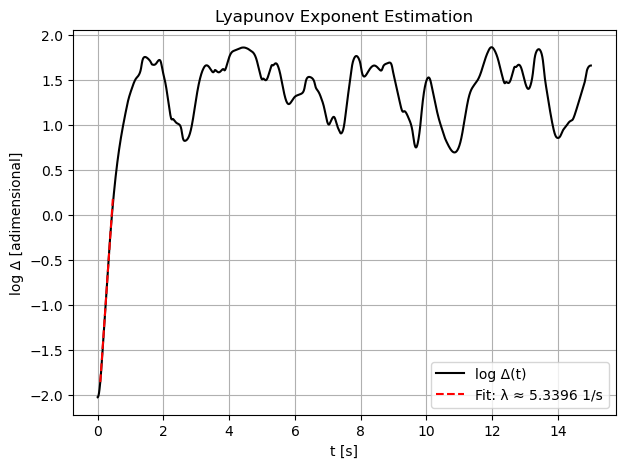

Estimated Lyapunov exponent: λ ≈ 5.3396 1/s


In [19]:
# -------------------------------------------------------------
# Lyapunov Exponent Estimation for the Double Pendulum
# -------------------------------------------------------------
# In this cell, we estimate the largest Lyapunov exponent (λ),
# which measures how quickly nearby trajectories diverge in
# phase space. A positive λ is the hallmark of chaos.
#
# Approach:
# - Evolve two trajectories with nearly identical initial conditions.
# - Compute their normalized distance in phase space.
# - Smooth Δ(t) to reduce noise.
# - Fit the exponential growth region of log Δ(t).
# -------------------------------------------------------------

# -------------------------------------------------------------
# High-resolution integration parameters
# -------------------------------------------------------------
steps = 100001
t = np.linspace(0, 15, steps) 
# We choose 15 s to capture the early exponential growth phase
# (after ~3 s the distance is already saturated).
dt = abs(t[0] - t[-1]) / (steps - 1)
t_span = (t[0], t[-1])
print(f"\nTime frame considered:\nFrom {t[0]} s to {t[-1]} s, with dt = {dt:.10f} s\n")

# -------------------------------------------------------------
# Solve ODEs for two slightly different initial conditions
# -------------------------------------------------------------
sol_ivp_b = solve_ivp(ivp_solver, t_span, initial_conditions1, args=par,
                      method="RK45", t_eval=t, rtol=1e-9, atol=1e-12)
sol_ivp_r = solve_ivp(ivp_solver, t_span, initial_conditions2, args=par,
                      method="RK45", t_eval=t, rtol=1e-9, atol=1e-12)

# Extract angular positions and velocities
b_theta1, b_w1, b_theta2, b_w2 = sol_ivp_b.y
r_theta1, r_w1, r_theta2, r_w2 = sol_ivp_r.y

# -------------------------------------------------------------
# Utility: angular difference modulo 2π (avoids artificial jumps)
# -------------------------------------------------------------
def diff_theta_mod(th1, th2):
    """Compute minimal angular difference between two angles."""
    return (th1 - th2 + np.pi) % (2*np.pi) - np.pi

# -------------------------------------------------------------
# Normalize phase-space distance (Δ) for adimensional measure
# -------------------------------------------------------------
w0_1 = np.sqrt(g/L1)  # typical ω for pendulum 1
w0_2 = np.sqrt(g/L2)  # typical ω for pendulum 2

delta_theta1 = diff_theta_mod(b_theta1, r_theta1)
delta_theta2 = diff_theta_mod(b_theta2, r_theta2)
delta_w1 = (b_w1 - r_w1) / w0_1
delta_w2 = (b_w2 - r_w2) / w0_2

# Euclidean norm in normalized phase space
delta = np.sqrt(delta_theta1**2 + delta_theta2**2 + delta_w1**2 + delta_w2**2)

# -------------------------------------------------------------
# Function to compute the largest Lyapunov exponent
# -------------------------------------------------------------
from scipy.ndimage import uniform_filter1d
from scipy.stats import linregress

def lyapunov_exponent(t, delta, smooth_window=2000):
     """
    Estimate the largest Lyapunov exponent λ.

    Steps:
    1. Smooth Δ(t) to reduce noise
    2. Compute log Δ(t)
    3. Detect region of exponential growth
    4. Linear fit → slope ≈ λ
    """

    # --- Step 1: Smooth Δ(t) to reduce noise ---
    delta_smooth = uniform_filter1d(delta, size=smooth_window)

    # --- Step 2: Log-transform ---
    log_delta = np.log(delta_smooth)

    # --- Step 3: Estimate growth rate by derivative ---
    dy = np.gradient(log_delta, t)

    # Select region where slope ~ maximum (exponential growth phase)
    max_slope = np.max(dy)
    mask = dy > 0.7 * max_slope  # keep ~70% of peak growth
    idx = np.where(mask)[0]

    if len(idx) == 0:
        raise RuntimeError("No exponential growth region detected!")
    i1, i2 = idx[0], idx[-1]

    # --- Step 4: Linear fit in selected region ---
    slope, intercept, r_value, _, _ = linregress(t[i1:i2], log_delta[i1:i2])
    lambda_est = slope

    # --- Plot log Δ(t) and the fitted line in the exponential region.
    # A positive slope indicates exponential divergence, i.e. chaos. ---
    fig, ax = plt.subplots(figsize=(7,5))
    ax.plot(t, log_delta, label="log Δ(t)", color="black")
    ax.plot(t[i1:i2], intercept + slope*t[i1:i2], 'r--',
            label=fr"Fit: λ ≈ {lambda_est:.4f} 1/s")
    ax.set_xlabel("t [s]")
    ax.set_ylabel("log Δ [adimensional]")
    ax.set_title("Lyapunov Exponent Estimation")
    ax.legend()
    ax.grid(True)
    plt.show()

    return lambda_est, (i1, i2)

# -------------------------------------------------------------
# Run the Lyapunov exponent estimation
# -------------------------------------------------------------
lam, fit_range = lyapunov_exponent(t, delta)
print(f"Estimated Lyapunov exponent: λ ≈ {lam:.4f} 1/s")


# -------------------------------------------------------------
# Conclusion
# -------------------------------------------------------------
# We have demonstrated the chaotic dynamics of the double pendulum:
# - Energy remains conserved → numerical accuracy
# - Trajectories with nearly identical initial conditions diverge
# - Phase space and Poincaré section reveal irregular structure
# - A positive Lyapunov exponent confirms chaos quantitatively
# -------------------------------------------------------------

